# Traffic Light Frozen Inference Model Tests

### Simulator and Real Track Test Images

Tests of traffic light detection/localization/classification on Udacity simulator images as well as Udacity real track images. 

# Imports

In [1]:
import numpy as np
import os
import sys
import tensorflow as tf

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

import time

# Tested with tensorflow 1.3


In [2]:
# This is needed to display the images withing the notbook.
%matplotlib inline

## Object detection imports
Here are the imports from the object detection module.

In [3]:
from utils import label_map_util

from utils import visualization_utils as vis_util

## Helper code

In [4]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `1`, we know that this corresponds to `Green`, 2 to `Red`, and 3 to `Yellow`.

In [5]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'tl_label_map.pbtxt'

NUM_CLASSES = 3

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

# Model preparation for trial_17_faster_rcnn_inc_sim-frozen_inference_graph

In [6]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'trial_17_faster_rcnn_inc_sim-frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## trial_17_faster_rcnn_inc_sim-frozen_inference_graph
## Detection on Sim Images

In [8]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_sim'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

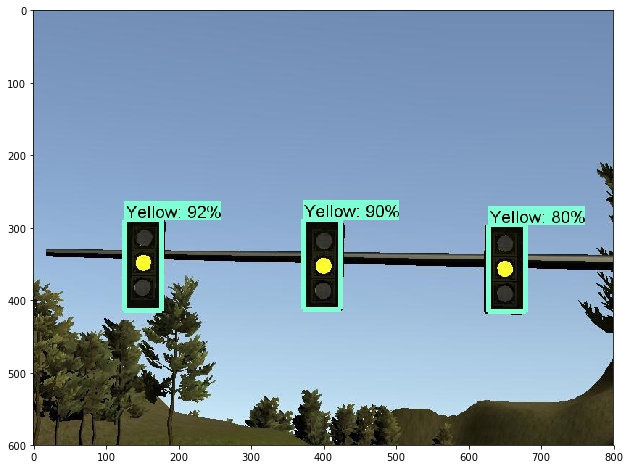

Time in ms:  3571.563482284546 



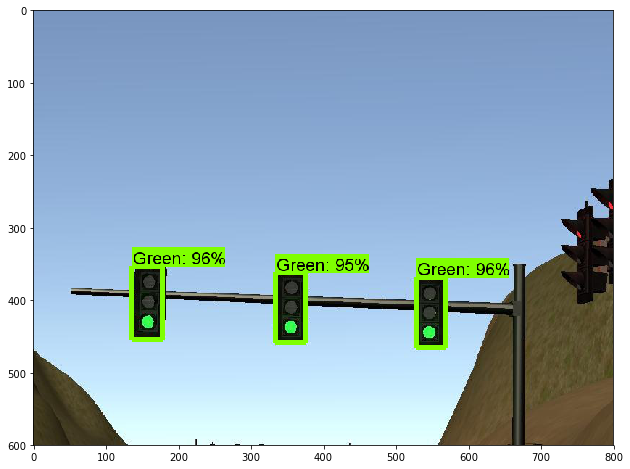

Time in ms:  55.6490421295166 



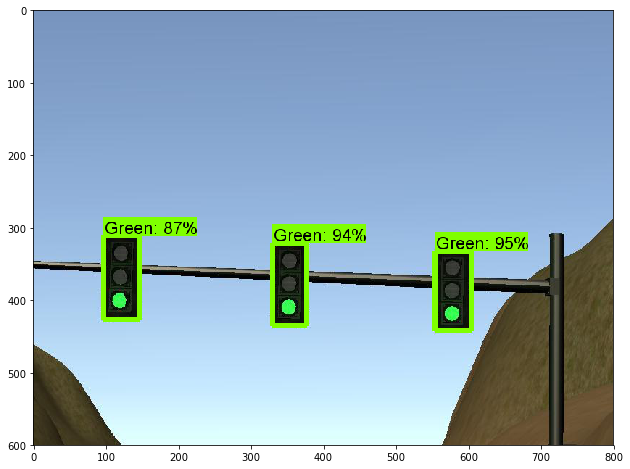

Time in ms:  56.65111541748047 



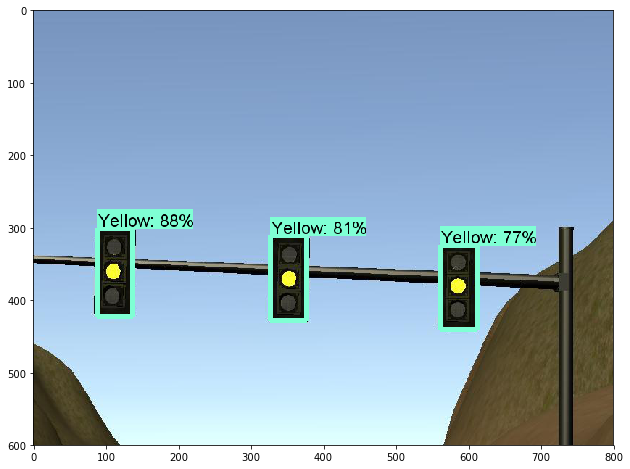

Time in ms:  56.65230751037598 



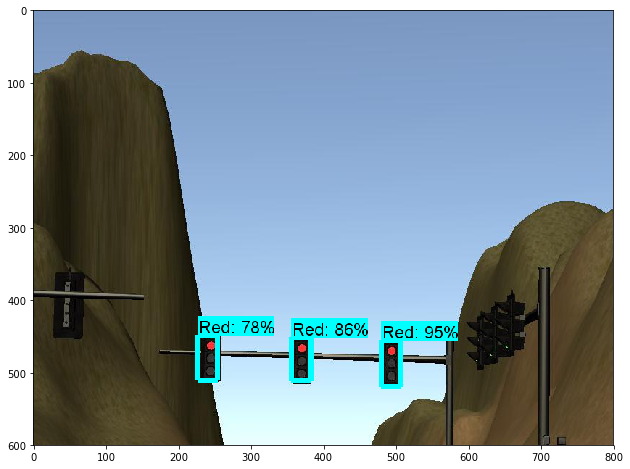

Time in ms:  51.13673210144043 



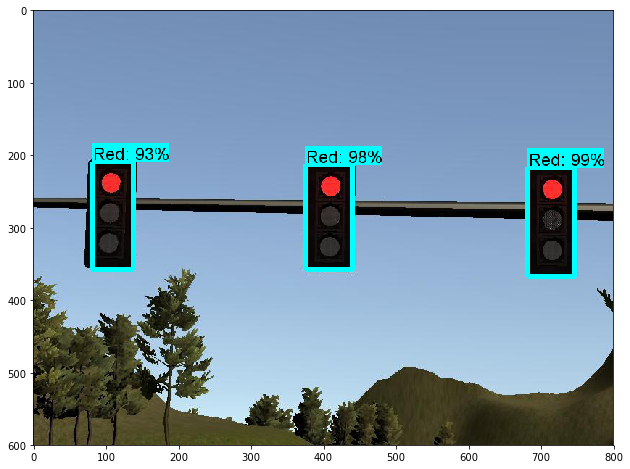

Time in ms:  57.15203285217285 



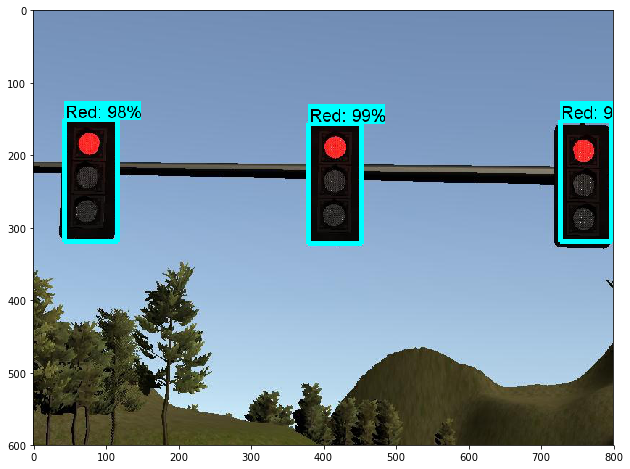

Time in ms:  58.155059814453125 



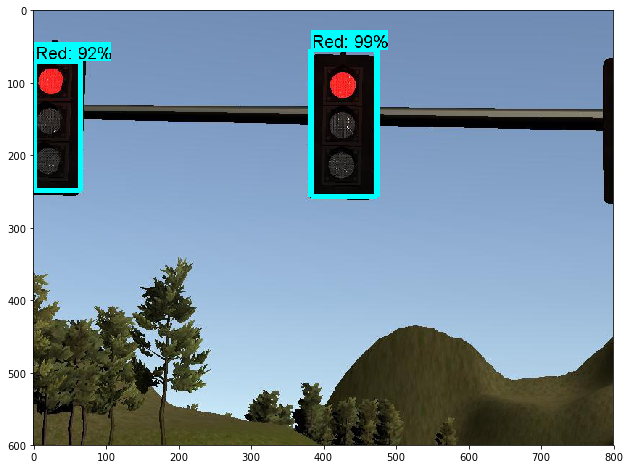

Time in ms:  56.65230751037598 



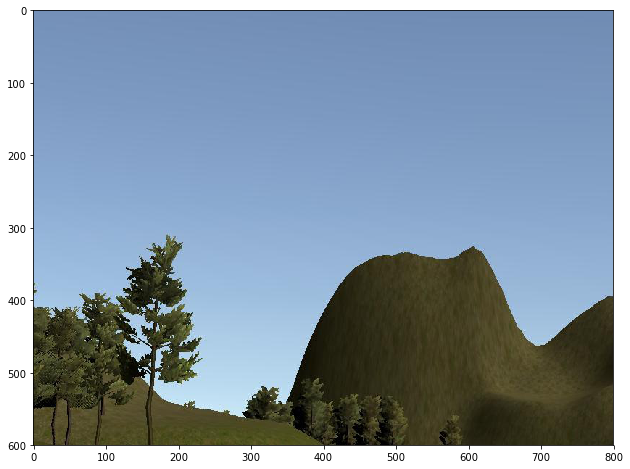

Time in ms:  52.64115333557129 



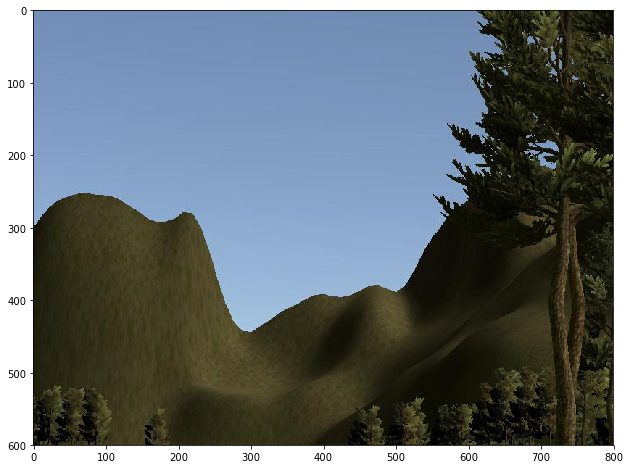

Time in ms:  50.13418197631836 



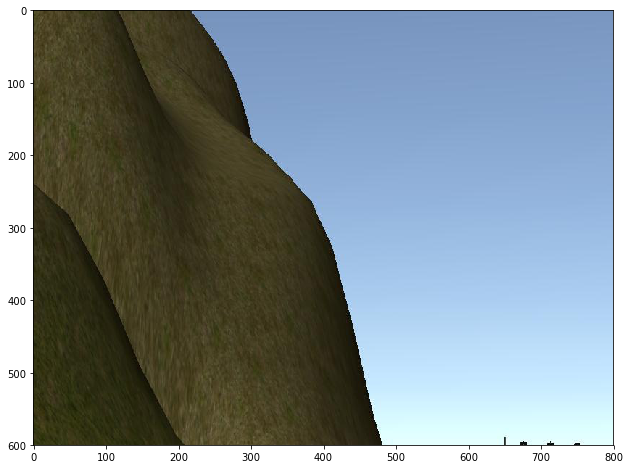

Time in ms:  52.640438079833984 



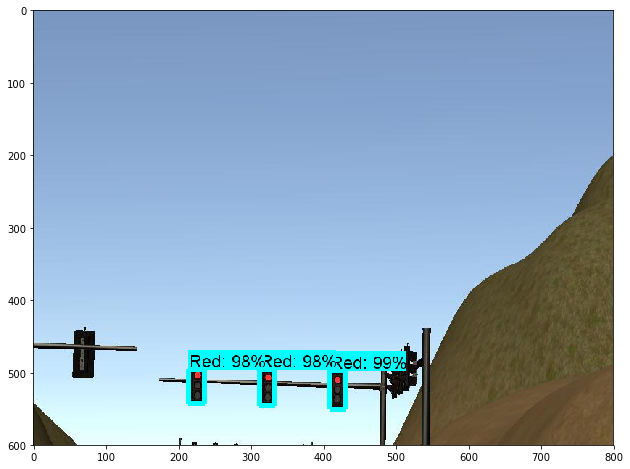

Time in ms:  52.64019966125488 



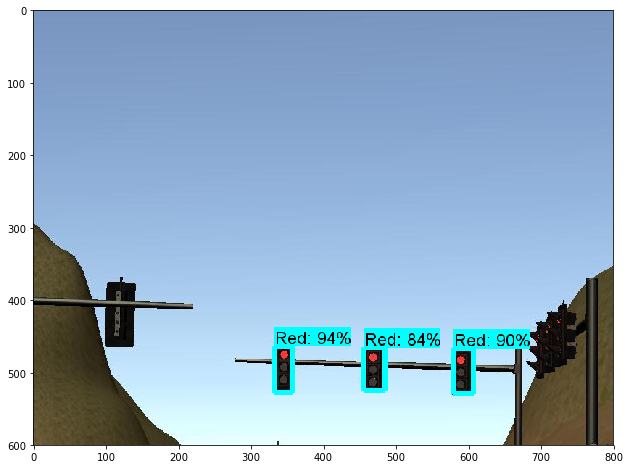

Time in ms:  51.13697052001953 



In [9]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")

# Model preparation for t18_faster_rcnn_inc_real_frozen_inference_graph

In [12]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 't18_faster_rcnn_inc_real_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [13]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## t18_faster_rcnn_inc_real_frozen_inference_graph
## Detection on Real Images from Test Track

In [16]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_real'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

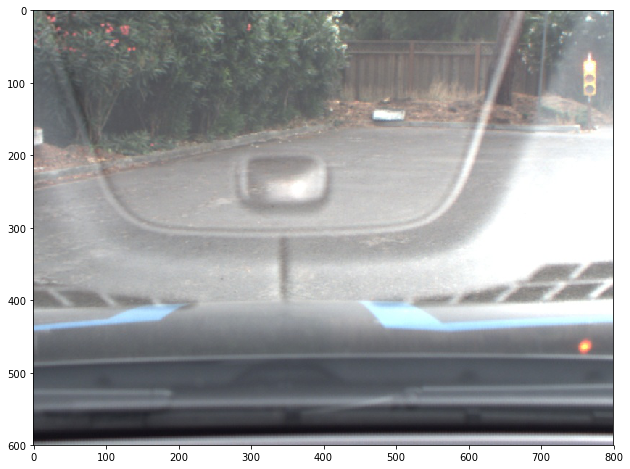

Time in ms:  1211.225986480713 



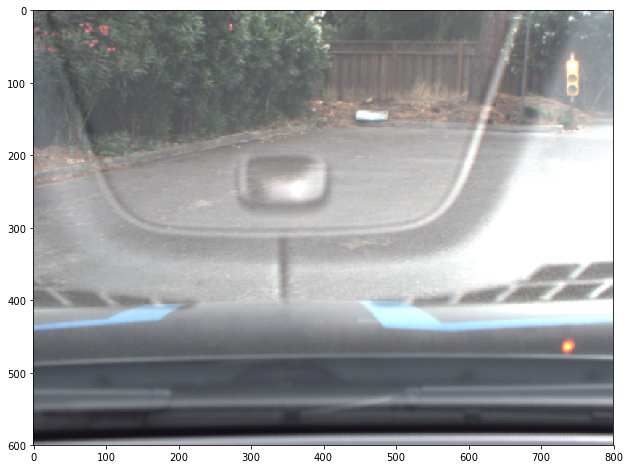

Time in ms:  102.27370262145996 



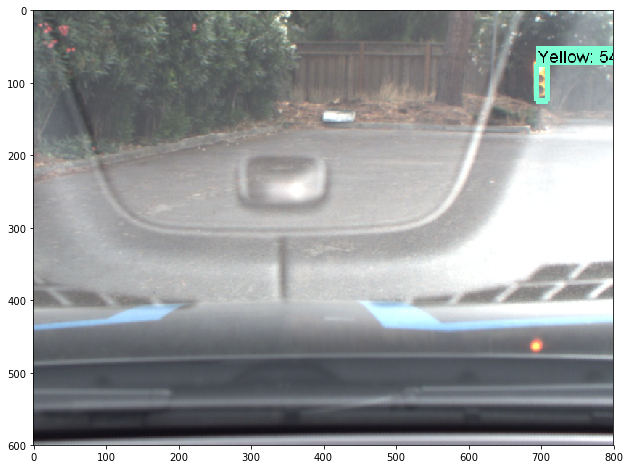

Time in ms:  102.27370262145996 



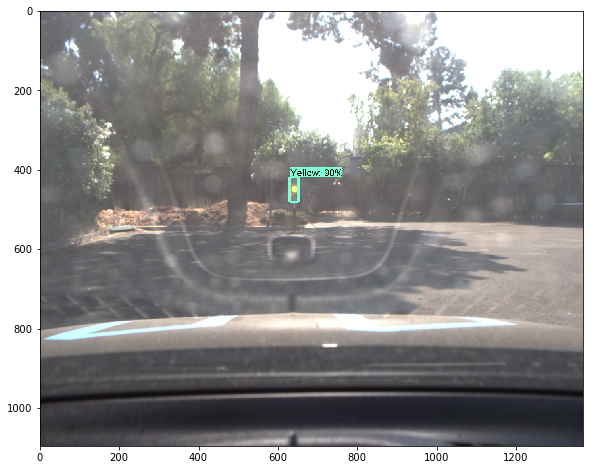

Time in ms:  764.0349864959717 



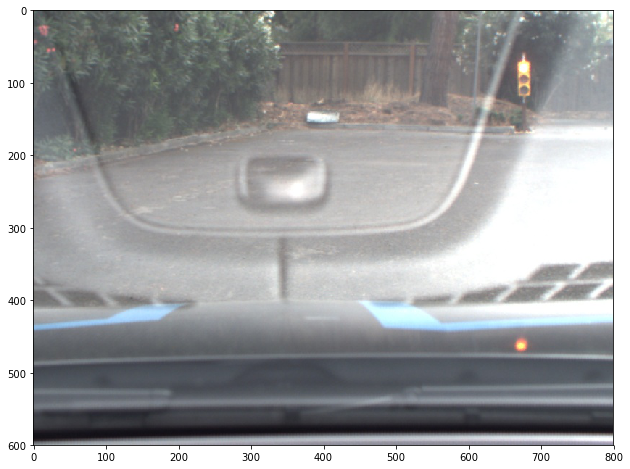

Time in ms:  102.27322578430176 



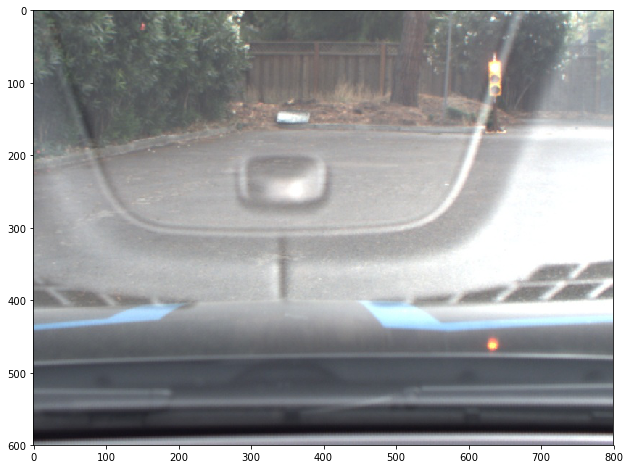

Time in ms:  101.77159309387207 



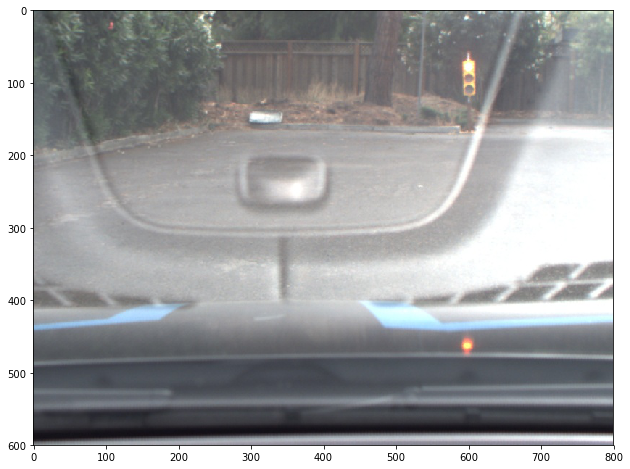

Time in ms:  103.7759780883789 



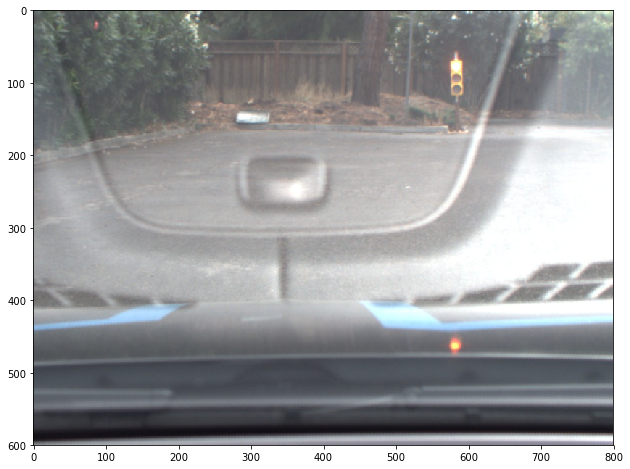

Time in ms:  104.278564453125 



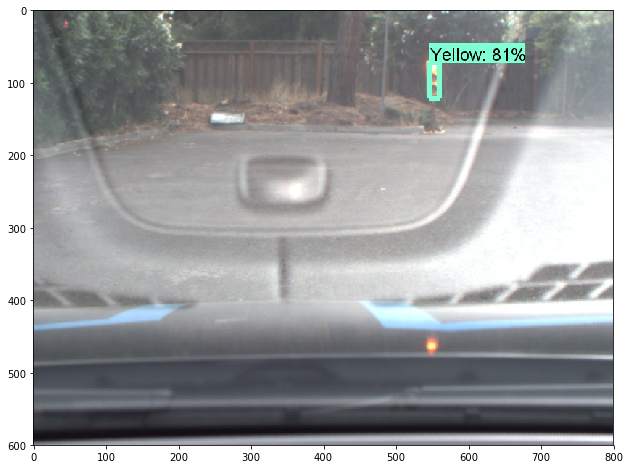

Time in ms:  102.27417945861816 



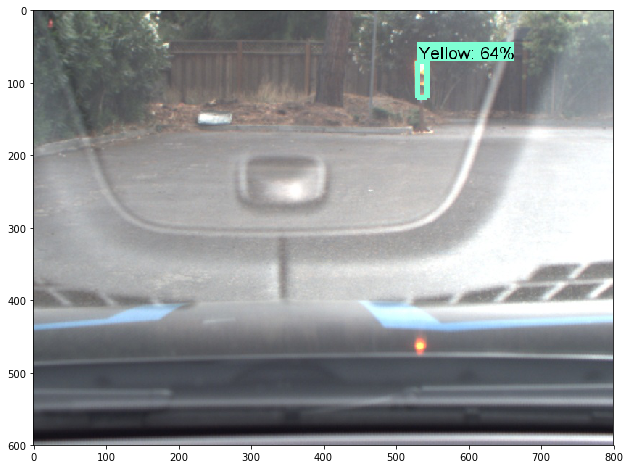

Time in ms:  101.77278518676758 



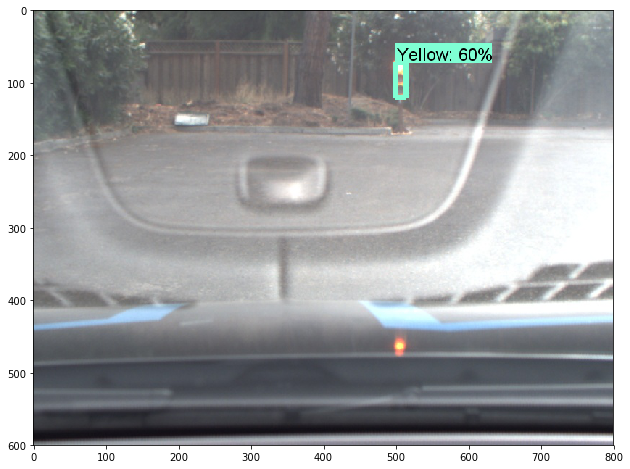

Time in ms:  102.27394104003906 



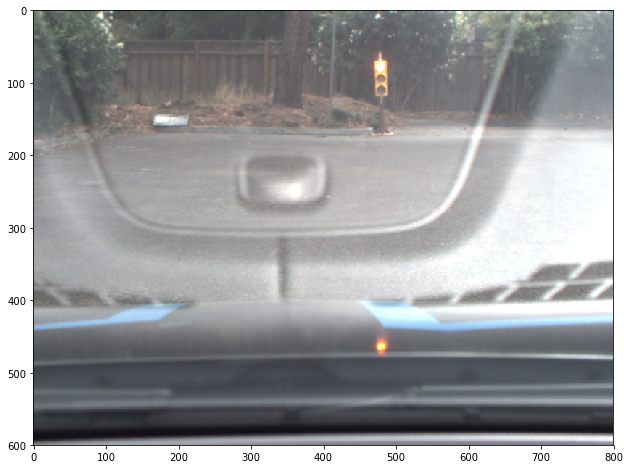

Time in ms:  101.77302360534668 



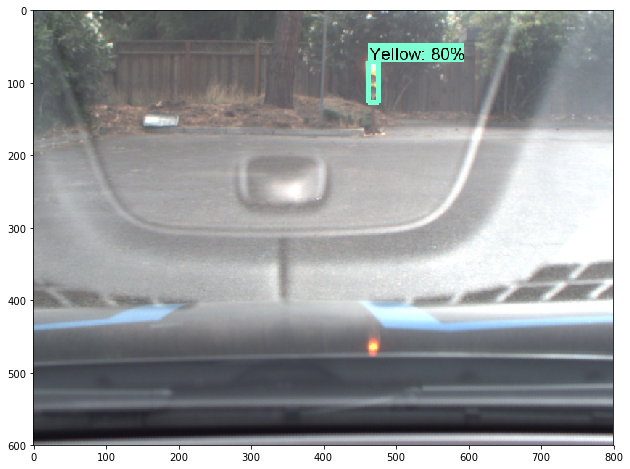

Time in ms:  101.27139091491699 



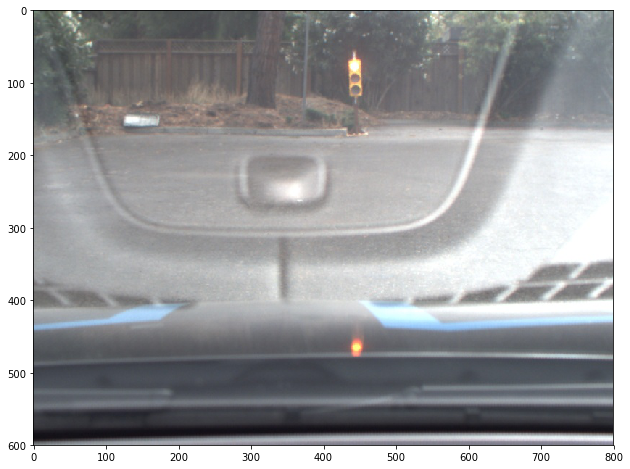

Time in ms:  106.28557205200195 



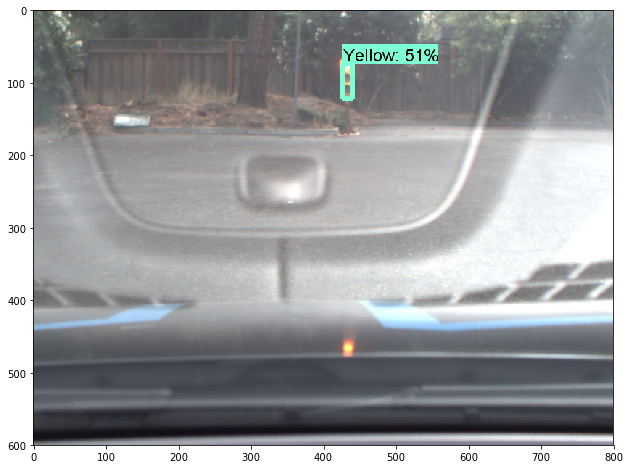

Time in ms:  101.77302360534668 



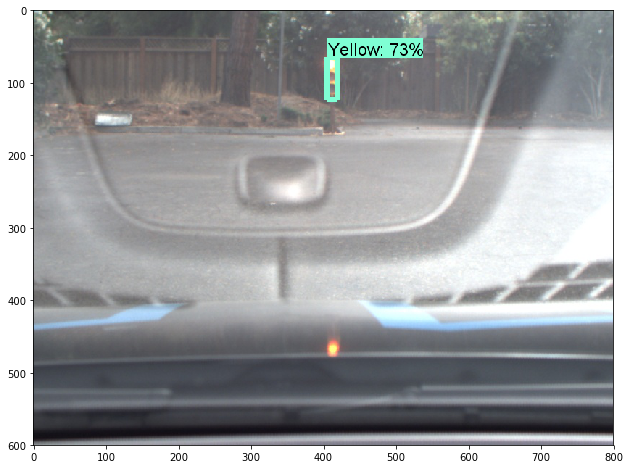

Time in ms:  98.26374053955078 



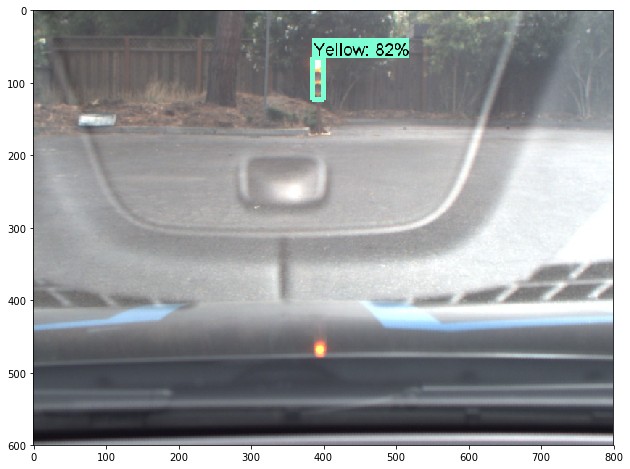

Time in ms:  104.78067398071289 



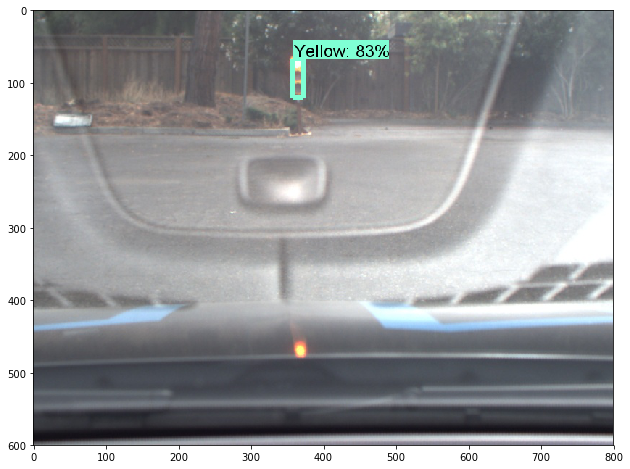

Time in ms:  106.28747940063477 



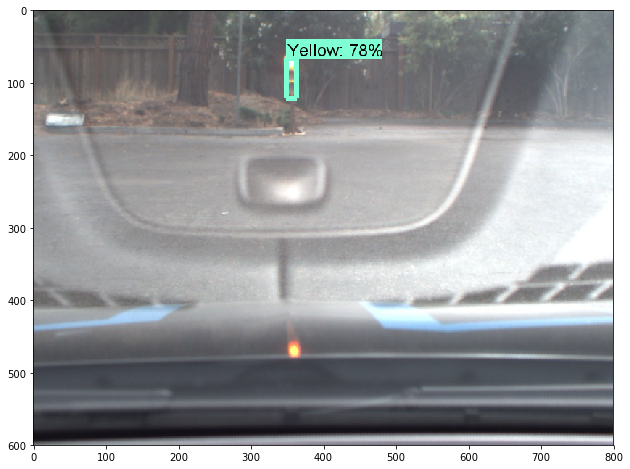

Time in ms:  102.27370262145996 



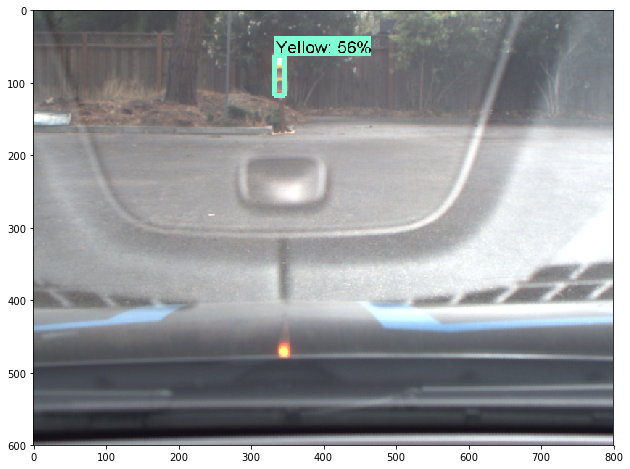

Time in ms:  104.2778491973877 



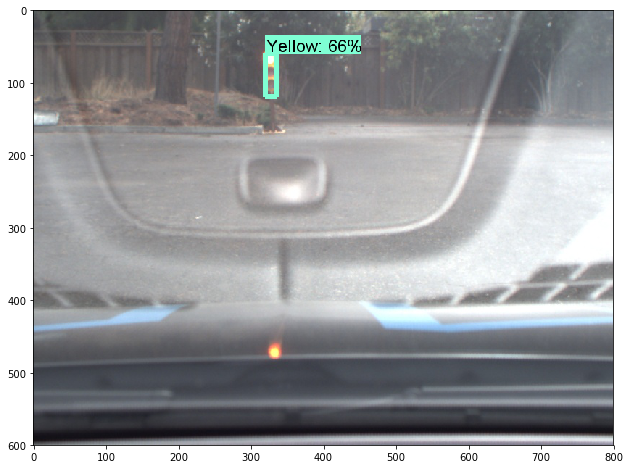

Time in ms:  103.77836227416992 



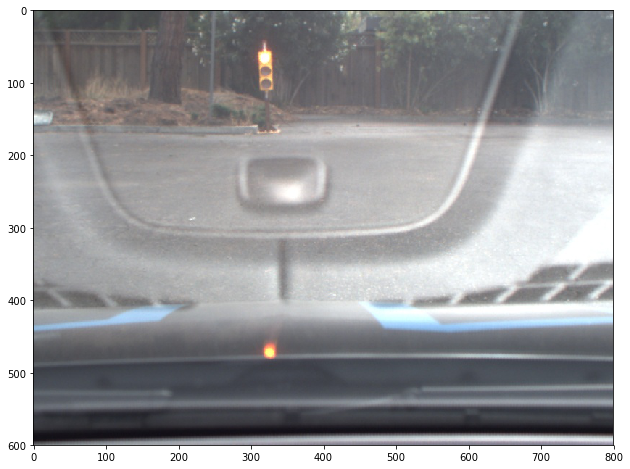

Time in ms:  106.78505897521973 



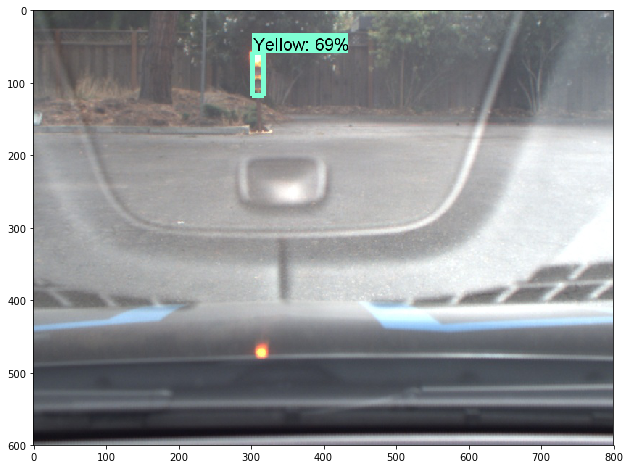

Time in ms:  103.27553749084473 



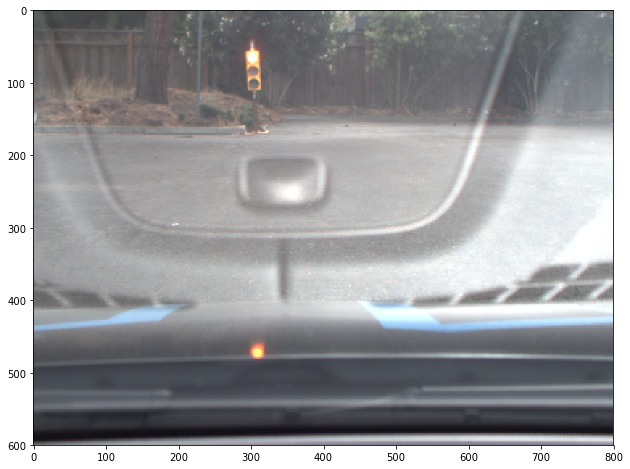

Time in ms:  105.28230667114258 



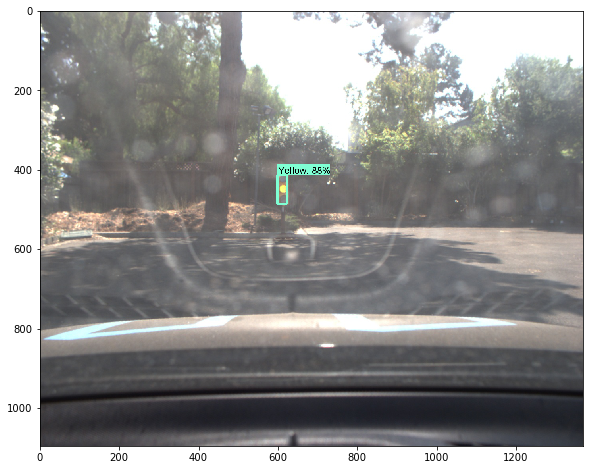

Time in ms:  109.29298400878906 



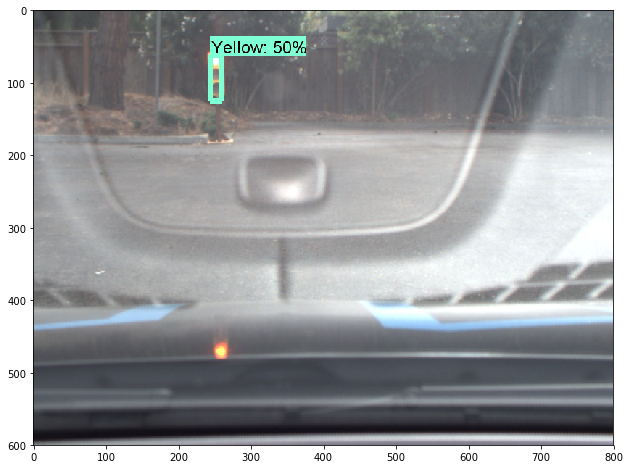

Time in ms:  105.28326034545898 



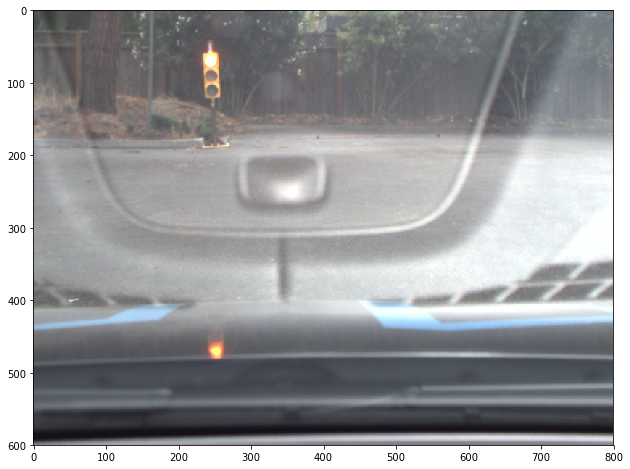

Time in ms:  101.27067565917969 



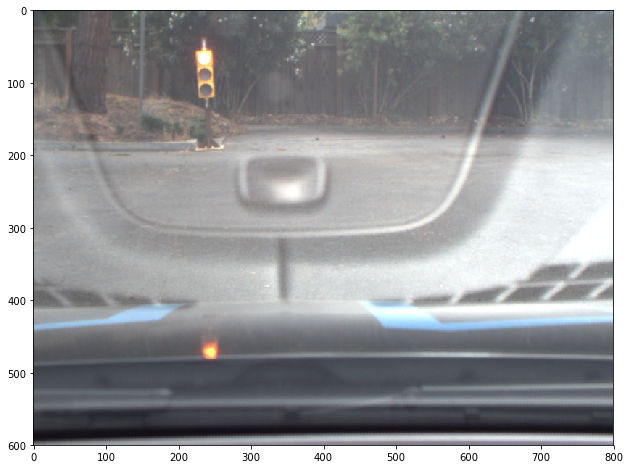

Time in ms:  103.77860069274902 



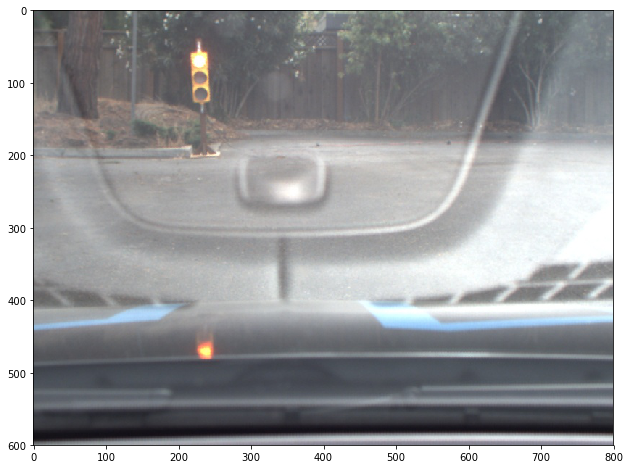

Time in ms:  103.27649116516113 



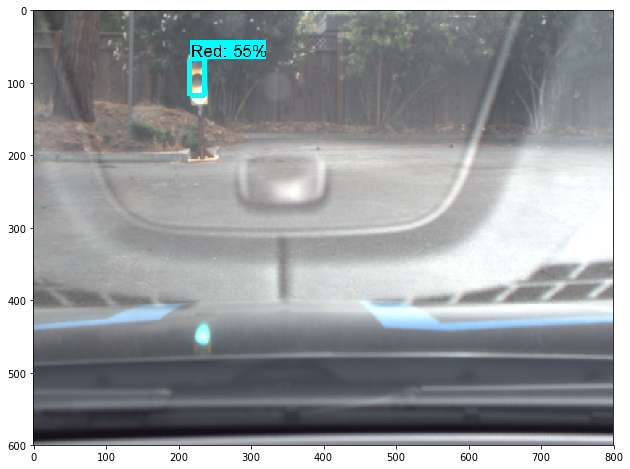

Time in ms:  103.27649116516113 



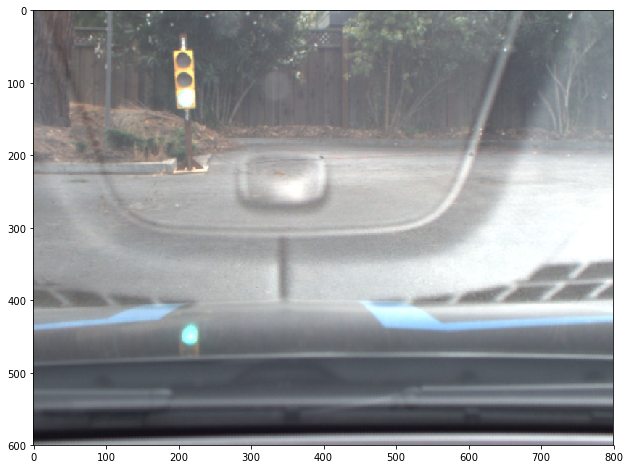

Time in ms:  104.2792797088623 



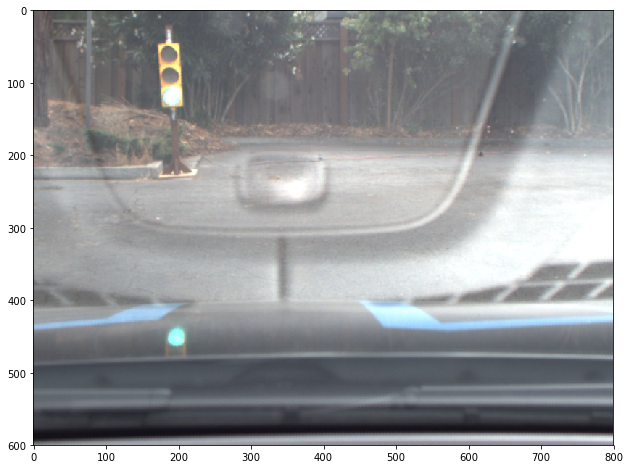

Time in ms:  104.27999496459961 



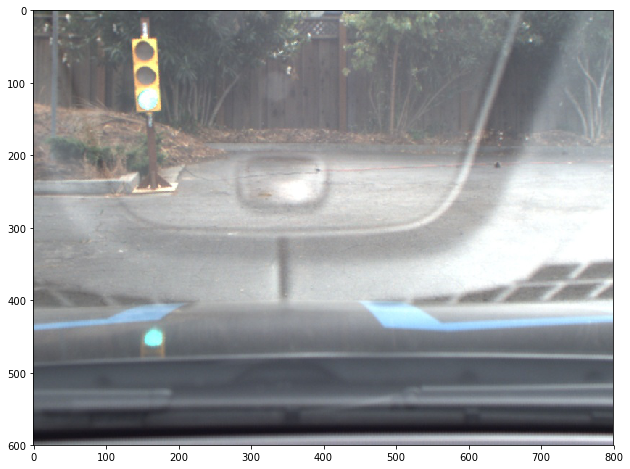

Time in ms:  100.7697582244873 



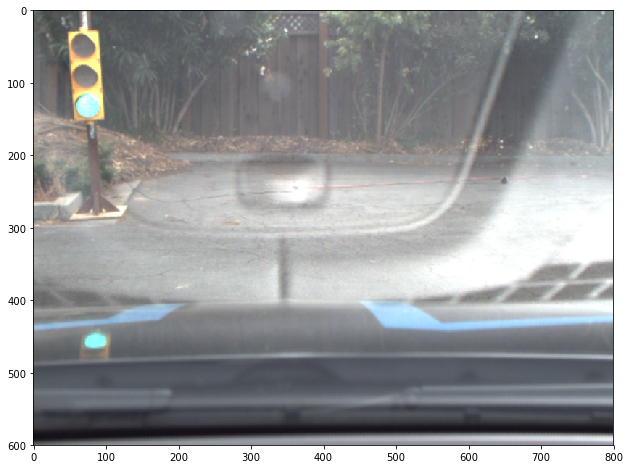

Time in ms:  102.27394104003906 



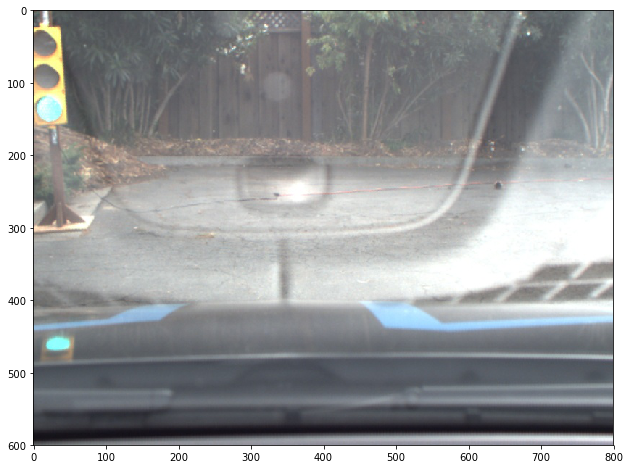

Time in ms:  101.77206993103027 



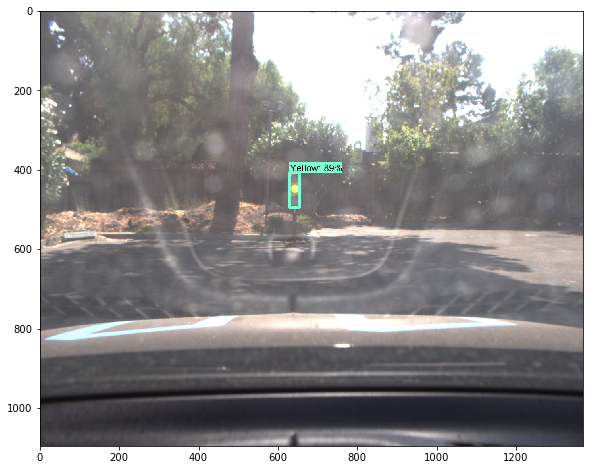

Time in ms:  109.79509353637695 



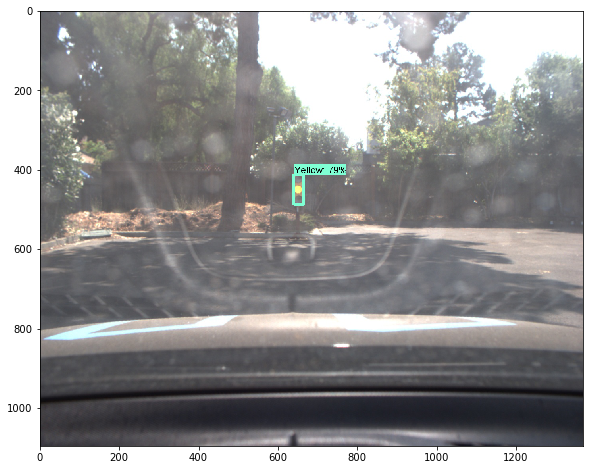

Time in ms:  105.78393936157227 



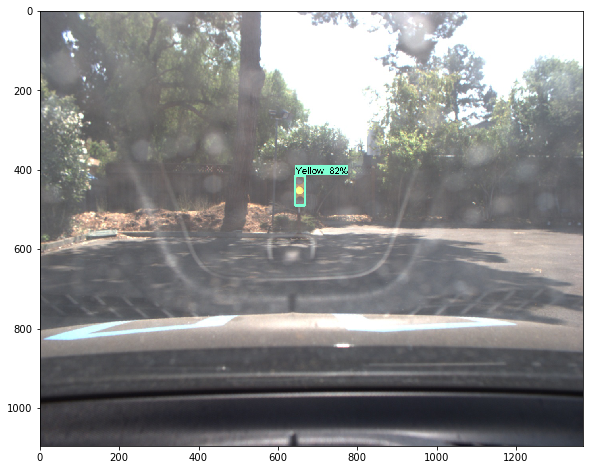

Time in ms:  104.7811508178711 



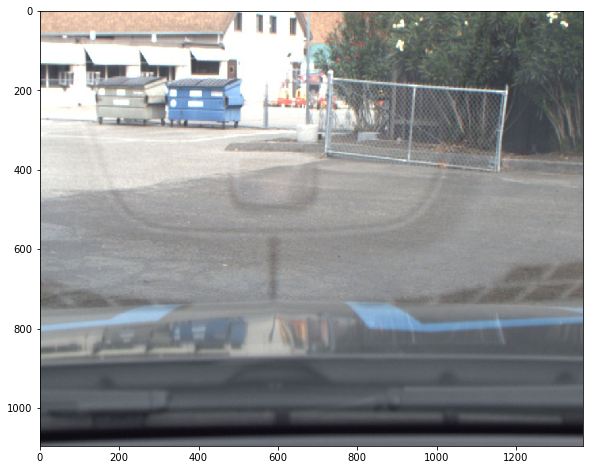

Time in ms:  103.27363014221191 



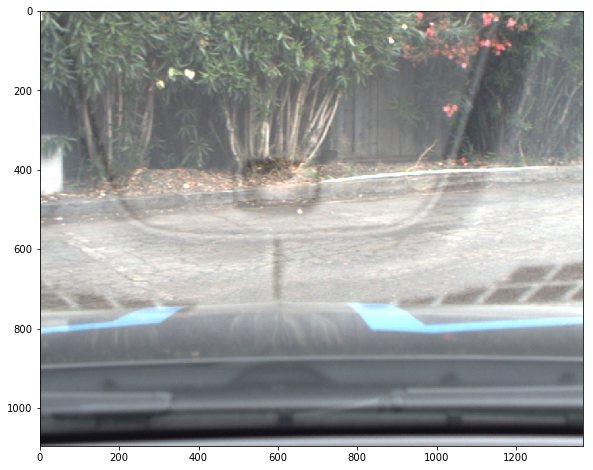

Time in ms:  103.7759780883789 



In [17]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")

# Model preparation for trial19_ssd_inception_sim_frozen_inference_graph

In [6]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'trial19_ssd_inception_sim_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## trial19_ssd_inception_sim_frozen_inference_graph
## Detection on Sim Images

In [8]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_sim'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

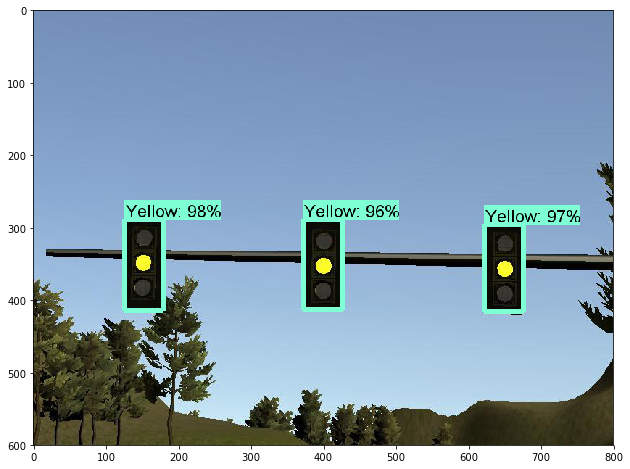

Time in ms:  2317.688226699829 



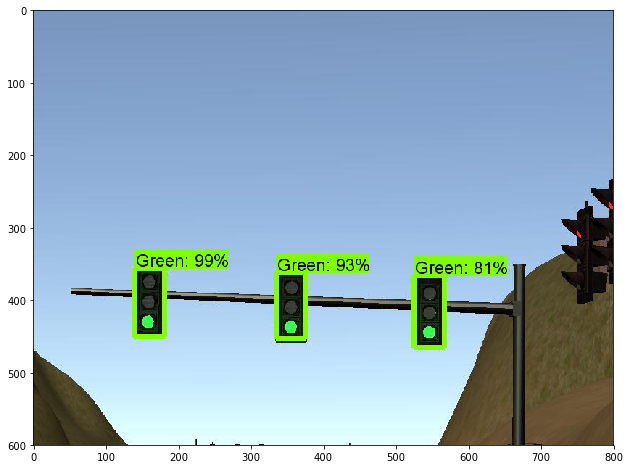

Time in ms:  16.043901443481445 



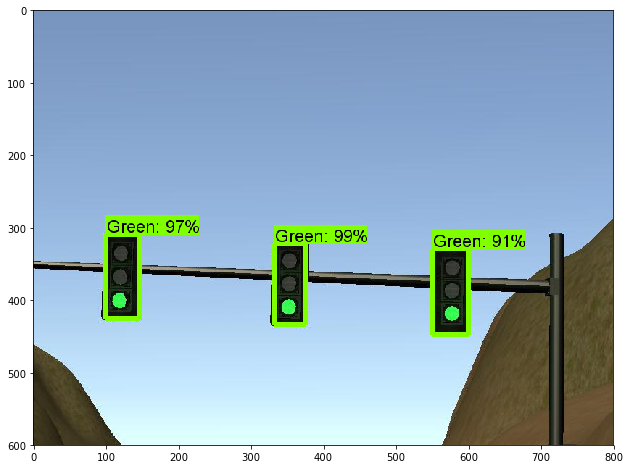

Time in ms:  15.542984008789062 



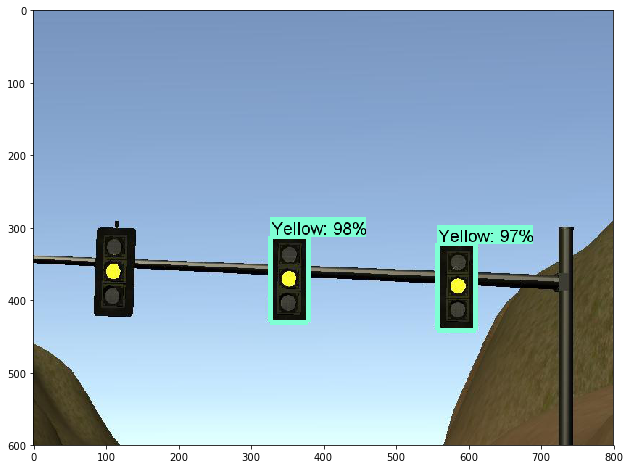

Time in ms:  17.046451568603516 



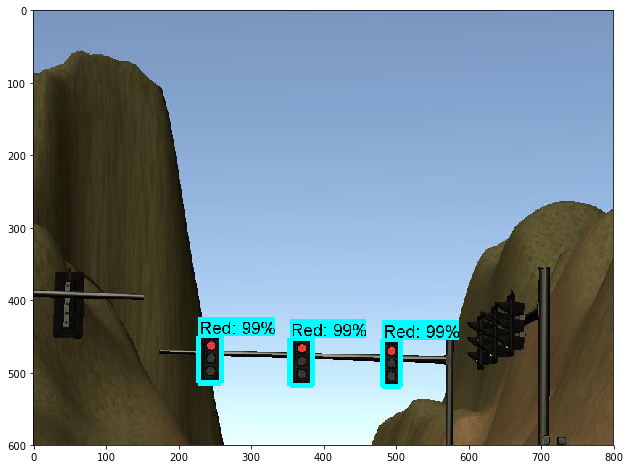

Time in ms:  16.544580459594727 



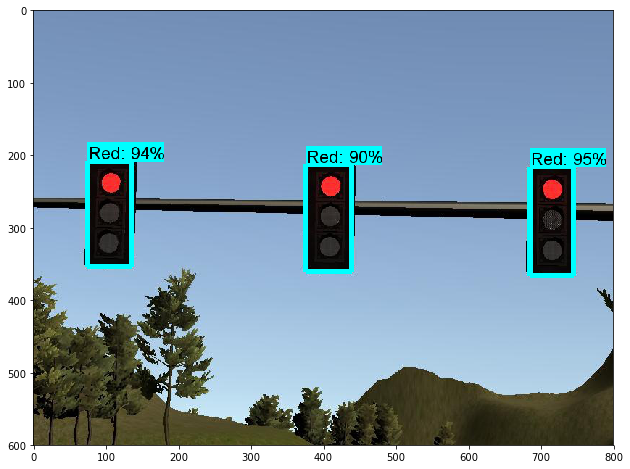

Time in ms:  17.044544219970703 



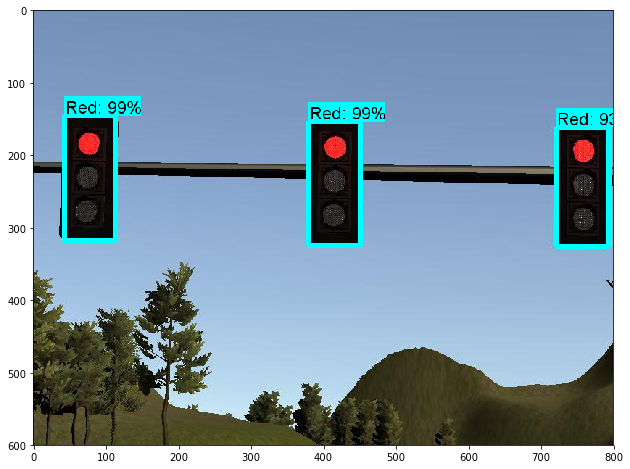

Time in ms:  17.045974731445312 



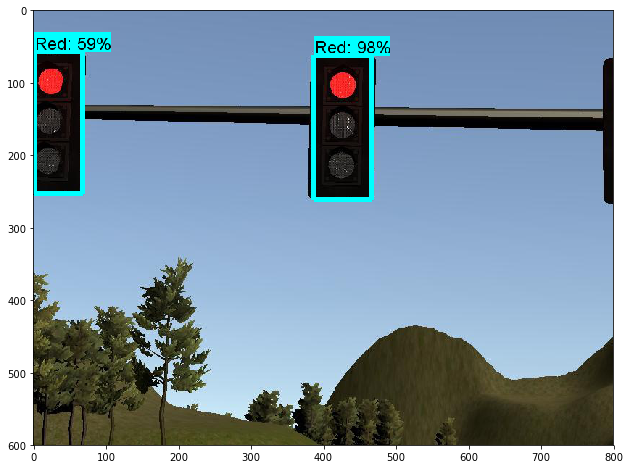

Time in ms:  17.548561096191406 



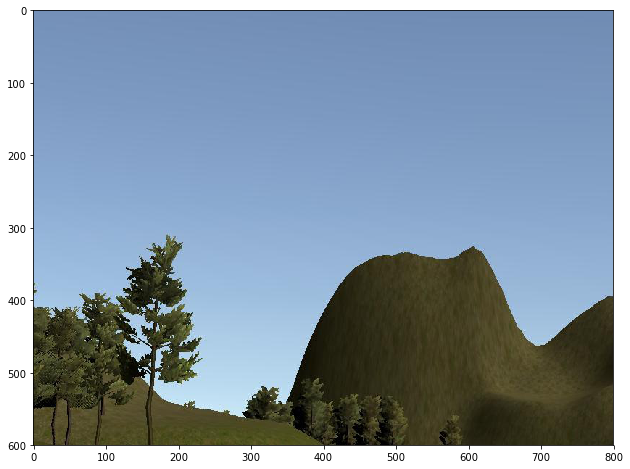

Time in ms:  16.543865203857422 



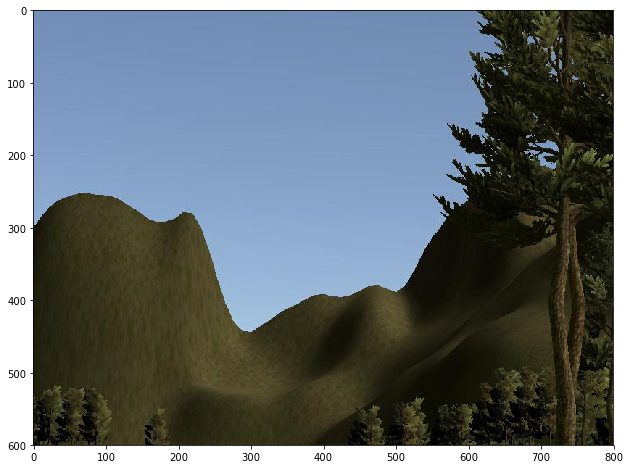

Time in ms:  17.548084259033203 



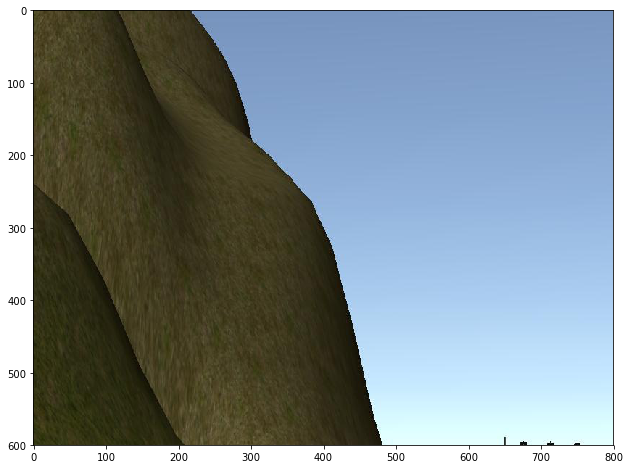

Time in ms:  16.543865203857422 



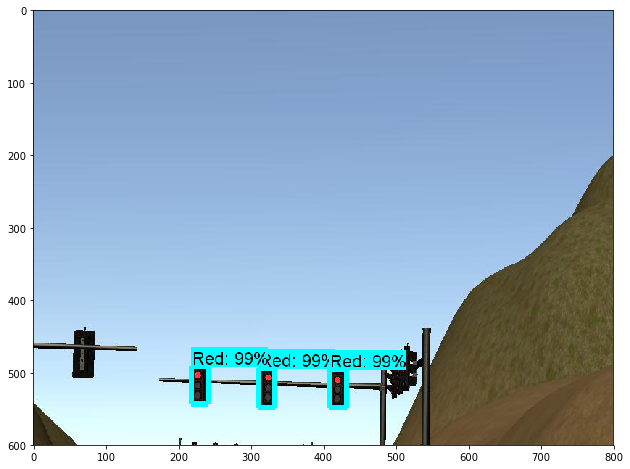

Time in ms:  16.54529571533203 



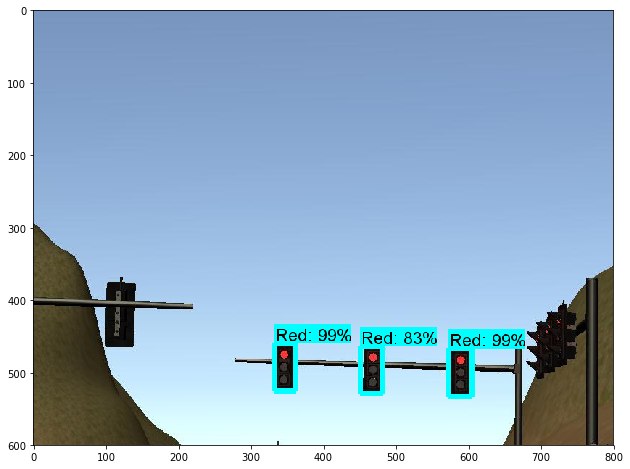

Time in ms:  16.544103622436523 



In [9]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")

# Model preparation for trial_15_ssd_inc_combine_6000_frozen_inference_graph

In [6]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'trial_15_ssd_inc_combine_6000_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## trial_15_ssd_inc_combine_6000_frozen_inference_graph
## Detection on Sim Images

In [8]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_sim'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

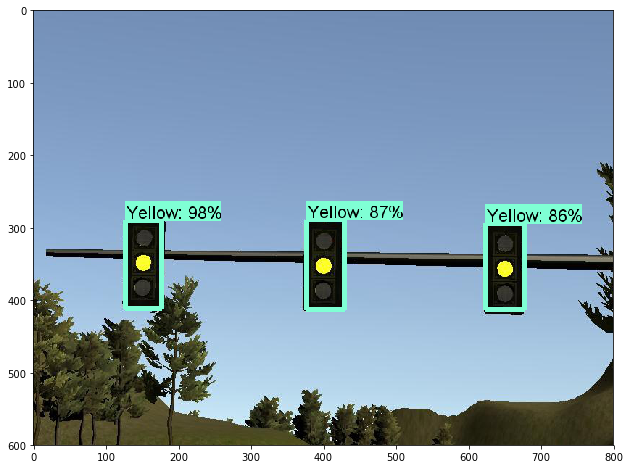

Time in ms:  2325.7124423980713 



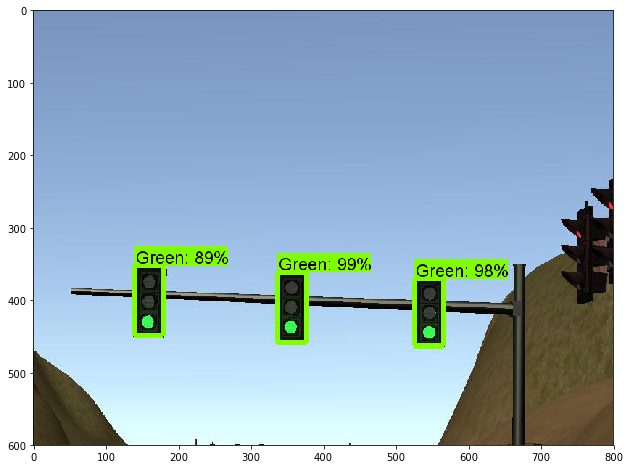

Time in ms:  17.046451568603516 



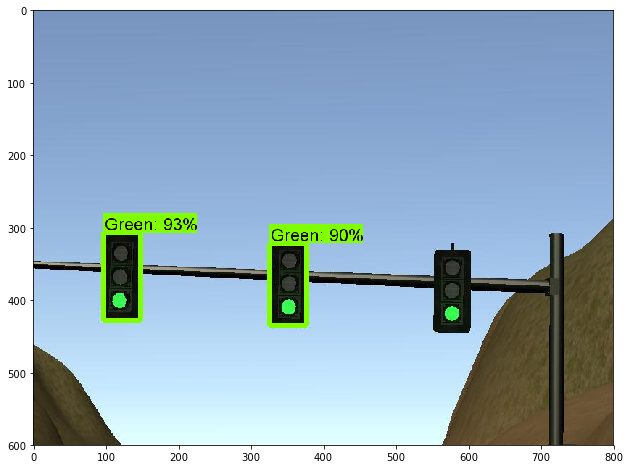

Time in ms:  17.546415328979492 



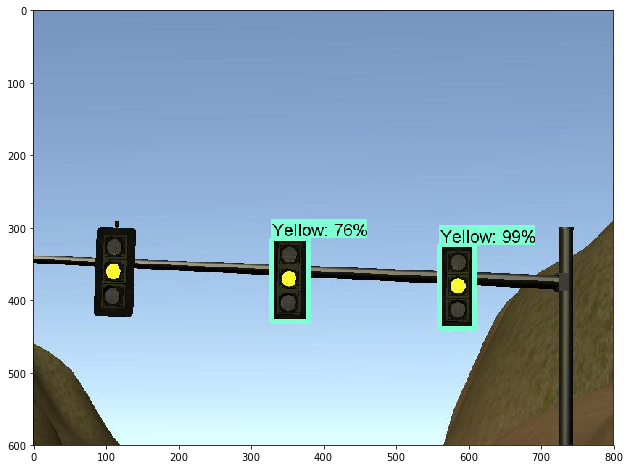

Time in ms:  18.04804801940918 



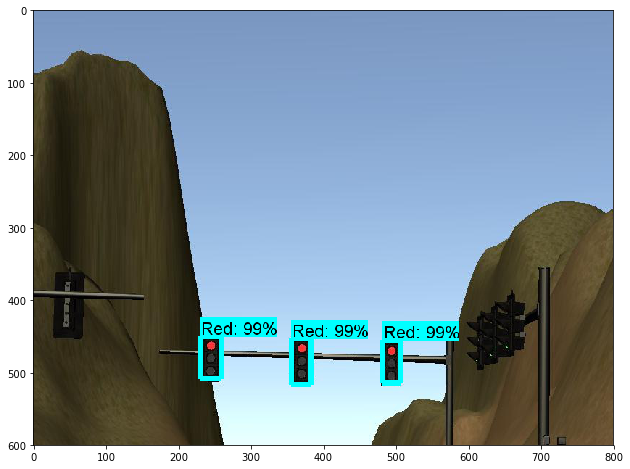

Time in ms:  17.546653747558594 



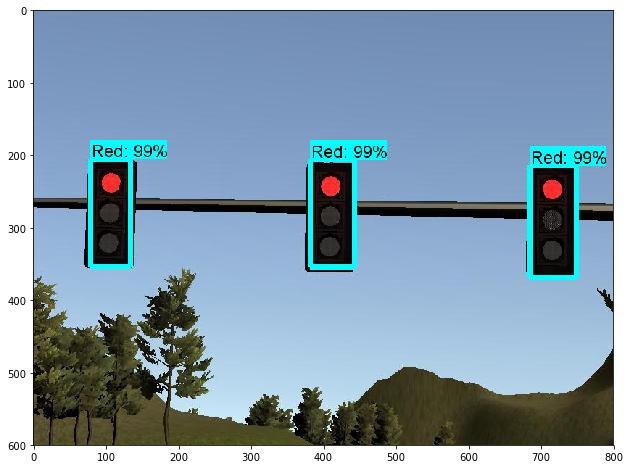

Time in ms:  17.0443058013916 



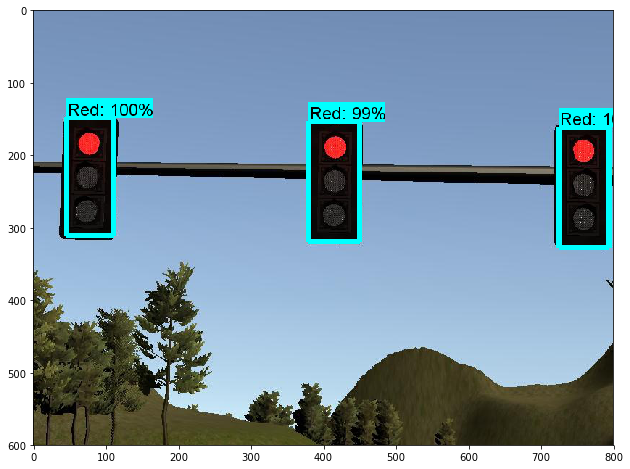

Time in ms:  17.5473690032959 



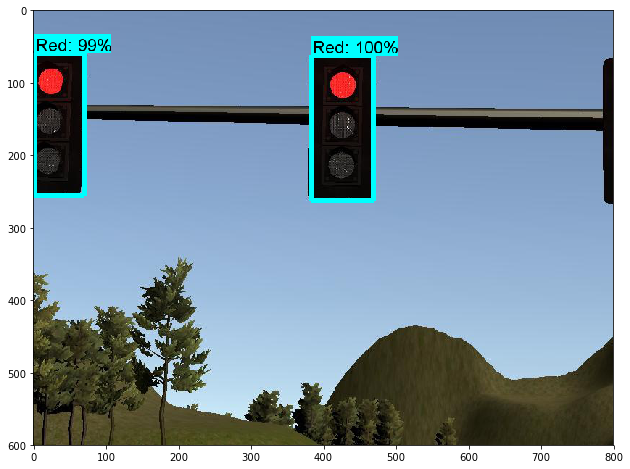

Time in ms:  16.54529571533203 



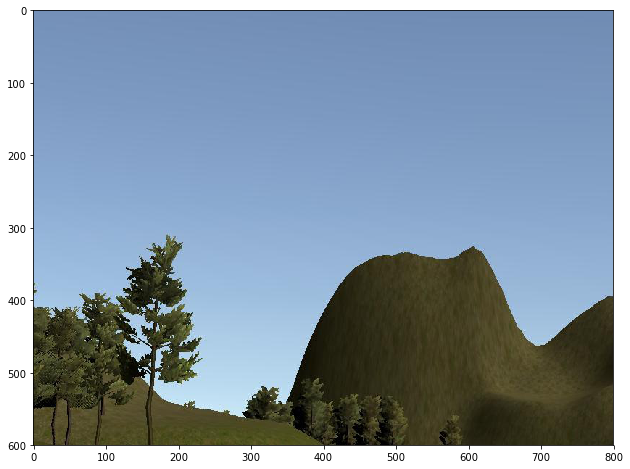

Time in ms:  17.046451568603516 



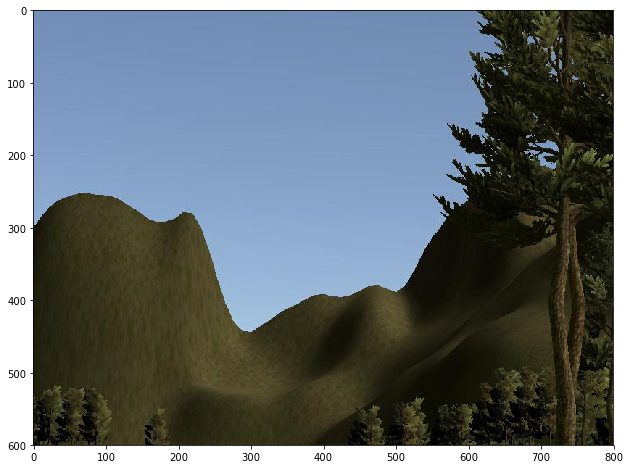

Time in ms:  17.546415328979492 



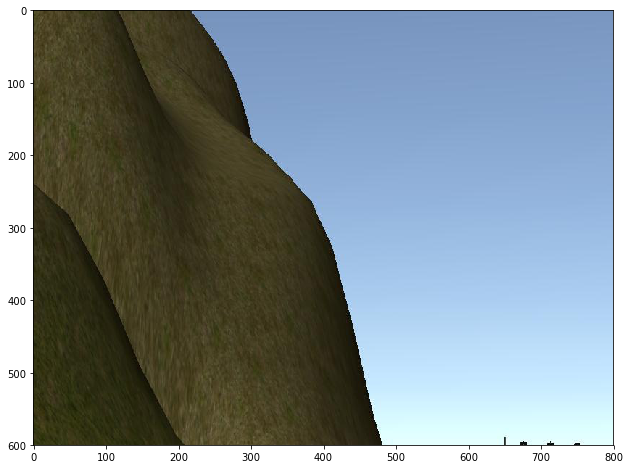

Time in ms:  17.04549789428711 



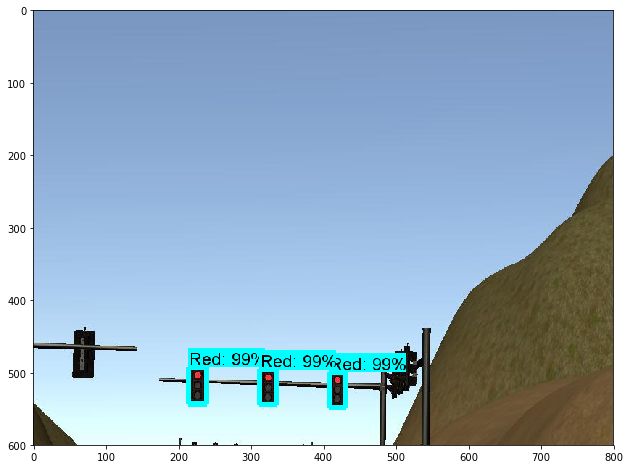

Time in ms:  18.04971694946289 



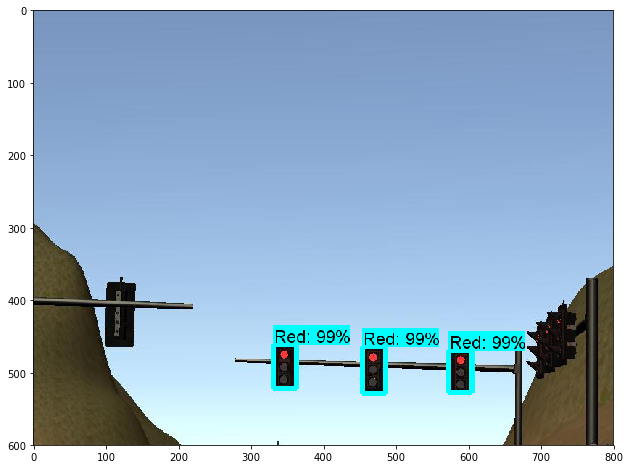

Time in ms:  18.047094345092773 



In [9]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")